## **Islamabad Weather Analysis 🌏**







> **Importing essential libraries**



In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline



> **Importing data**



In [ ]:
data = pd.read_csv('islamabad.csv')

In [ ]:
data.sample(5)

,date_time,maxtempC,mintempC,uvIndex,DewPointC,FeelsLikeC,HeatIndexC,WindGustKmph,cloudcover,humidity,precipMM,pressure,tempC,visibility,winddirDegree,windspeedKmph,weatherDesc,location
5391,2021-11-04 21:00:00,26,14,6,3,18,18,20,12,36,0.0,1015,18,10,54,9,Clear,islamabad
881,2020-04-20 03:00:00,25,20,6,10,21,21,17,21,50,0.0,1010,21,10,44,9,Thundery outbreaks possible,islamabad
2637,2020-11-25 15:00:00,15,11,3,7,14,14,8,83,63,0.2,1021,14,3,27,6,Patchy light drizzle,islamabad
3800,2021-04-20 00:00:00,27,19,6,8,24,24,13,7,38,0.0,1008,23,10,17,8,Partly cloudy,islamabad
1318,2020-06-13 18:00:00,44,27,9,14,47,47,8,0,21,0.0,999,44,10,66,6,Clear,islamabad




> **Data Analysis**



In [ ]:
display("Shape: ",data.shape)
display("Columns: ",data.columns)

'Shape: '

(5840, 18)

'Columns: '

Index(['date_time', 'maxtempC', 'mintempC', 'uvIndex', 'DewPointC',
       'FeelsLikeC', 'HeatIndexC', 'WindGustKmph', 'cloudcover', 'humidity',
       'precipMM', 'pressure', 'tempC', 'visibility', 'winddirDegree',
       'windspeedKmph', 'weatherDesc', 'location'],
      dtype='object')

In [ ]:
display(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5840 entries, 0 to 5839
Data columns (total 18 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   date_time      5840 non-null   object 
 1   maxtempC       5840 non-null   int64  
 2   mintempC       5840 non-null   int64  
 3   uvIndex        5840 non-null   int64  
 4   DewPointC      5840 non-null   int64  
 5   FeelsLikeC     5840 non-null   int64  
 6   HeatIndexC     5840 non-null   int64  
 7   WindGustKmph   5840 non-null   int64  
 8   cloudcover     5840 non-null   int64  
 9   humidity       5840 non-null   int64  
 10  precipMM       5840 non-null   float64
 11  pressure       5840 non-null   int64  
 12  tempC          5840 non-null   int64  
 13  visibility     5840 non-null   int64  
 14  winddirDegree  5840 non-null   int64  
 15  windspeedKmph  5840 non-null   int64  
 16  weatherDesc    5840 non-null   object 
 17  location       5840 non-null   object 
dtypes: float

None

In [ ]:
#Check total missing values in each feature
data.isnull().sum()

date_time        0
maxtempC         0
mintempC         0
uvIndex          0
DewPointC        0
FeelsLikeC       0
HeatIndexC       0
WindGustKmph     0
cloudcover       0
humidity         0
precipMM         0
pressure         0
tempC            0
visibility       0
winddirDegree    0
windspeedKmph    0
weatherDesc      0
location         0
dtype: int64



> **Exploratory Data Visualization**



In [ ]:
!pip install dataprep

/usr/local/lib/python3.7/dist-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  return getattr(obj, self.method)(*args, **kwargs)
/usr/local/lib/python3.7/dist-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  return getattr(obj, self.method)(*args, **kwargs)
/usr/local/lib/python3.7/dist-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  return getattr(obj, self.method)(*args, **kwargs)
/usr/local/lib/python3.7/dist-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  return getattr(obj, self.method)(*args, **kwargs)
/usr/local/lib/python3.7/dist-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infav

DataPrep Report
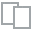
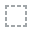
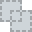
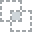
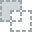
...
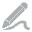
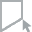
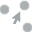
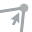
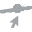

In [ ]:
from dataprep.eda import create_report
create_report(data)



> **Feature Engineering**



In [ ]:
data['weatherDesc'].value_counts() < 70

Partly cloudy                          False
Clear                                  False
Sunny                                  False
Patchy rain possible                   False
Moderate or heavy rain shower          False
Overcast                               False
Light rain shower                      False
Patchy light rain with thunder         False
Cloudy                                 False
Moderate rain at times                  True
Thundery outbreaks possible             True
Heavy rain                              True
Torrential rain shower                  True
Patchy light drizzle                    True
Moderate rain                           True
Light rain                              True
Patchy light rain                       True
Light drizzle                           True
Heavy rain at times                     True
Moderate or heavy rain with thunder     True
Name: weatherDesc, dtype: bool

In [ ]:
counts = data['weatherDesc'].value_counts()

df = data[~data['weatherDesc'].isin(counts[counts < 70].index)]

In [ ]:
df['weatherDesc'].value_counts()

Partly cloudy                     2616
Clear                              829
Sunny                              817
Patchy rain possible               763
Moderate or heavy rain shower      147
Overcast                           124
Light rain shower                  111
Patchy light rain with thunder     101
Cloudy                              74
Name: weatherDesc, dtype: int64

In [ ]:
df.drop(columns=['date_time','location'],inplace=True)

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4913: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [ ]:
!pip install category_encoders

In [ ]:
import category_encoders as ce

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [ ]:
encoder= ce.OrdinalEncoder(cols=['weatherDesc'],return_df=True,
                           mapping=[{'col':'weatherDesc',
'mapping':{'Partly cloudy':0,'Clear':1,'Sunny':2,'Patchy rain possible':3,'Moderate or heavy rain shower':4,'Overcast':5,'Light rain shower':6,'Patchy light rain with thunder':7,'Cloudy':8}}])

In [ ]:
df['weatherDesc'].astype(str)

0       Partly cloudy
1       Partly cloudy
2       Partly cloudy
3       Partly cloudy
4       Partly cloudy
            ...      
5835         Overcast
5836    Partly cloudy
5837    Partly cloudy
5838    Partly cloudy
5839            Clear
Name: weatherDesc, Length: 5582, dtype: object

In [ ]:
df['weatherDesc'] = encoder.fit_transform(df['weatherDesc'])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [ ]:
df.sample(5)

,maxtempC,mintempC,uvIndex,DewPointC,FeelsLikeC,HeatIndexC,WindGustKmph,cloudcover,humidity,precipMM,pressure,tempC,visibility,winddirDegree,windspeedKmph,weatherDesc
3340,27,15,6,2,24,24,11,8,21,0.0,1018,25,10,273,9,0
107,13,7,3,5,8,9,12,71,78,2.2,1019,9,9,142,8,3
1545,39,31,8,17,33,33,15,82,42,0.4,995,32,10,111,11,3
3700,27,12,6,11,26,26,8,73,40,0.8,1009,25,10,178,6,7
1459,43,32,9,14,39,39,9,4,23,0.0,1000,39,10,304,8,0




> **Preparing Data for model**



In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report

In [ ]:
columns_to_scale = list(df.columns)[:-1]
standardScaler = StandardScaler()
df[columns_to_scale] = standardScaler.fit_transform(df[columns_to_scale])

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:3678: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[col] = igetitem(value, i)


In [ ]:
df.sample(5)

,maxtempC,mintempC,uvIndex,DewPointC,FeelsLikeC,HeatIndexC,WindGustKmph,cloudcover,humidity,precipMM,pressure,tempC,visibility,winddirDegree,windspeedKmph,weatherDesc
4021,0.684174,0.726691,0.292321,-0.029939,0.934804,0.934610,1.128946,-0.826780,-1.202821,-0.245386,-0.481357,1.195457,0.295168,1.137233,2.515495,2
3262,-0.517808,-0.875309,-0.281224,-0.608204,-0.156657,-0.177367,-0.397524,-0.826780,-0.685716,-0.245386,0.439502,-0.105542,0.295168,1.322255,0.066919,1
522,-1.479394,-0.998540,-0.854768,-0.145592,-1.248117,-1.289345,-0.227916,0.828327,1.612527,-0.245386,0.307951,-1.298124,0.295168,-1.046025,-0.477209,3
4024,1.044768,1.096383,1.439410,0.317020,0.438685,0.429166,-0.567132,-0.826780,-0.570804,-0.245386,-0.481357,0.653374,0.295168,0.674679,-0.205145,1
4655,0.563975,0.356998,0.292321,1.704855,1.034027,1.035699,-0.397524,-0.567156,1.267791,-0.245386,-1.270664,0.653374,0.295168,-0.805497,-0.205145,0


In [ ]:
X= df.drop(['weatherDesc'], axis=1)
y= df['weatherDesc']

In [ ]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [ ]:
!pip install -U mljar-supervised

ERROR: Operation cancelled by user
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/pip/_vendor/pkg_resources/__init__.py", line 3021, in _dep_map
    return self.__dep_map
  File "/usr/local/lib/python3.7/dist-packages/pip/_vendor/pkg_resources/__init__.py", line 2815, in __getattr__
    raise AttributeError(attr)
AttributeError: _DistInfoDistribution__dep_map

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/pip/_internal/cli/base_command.py", line 180, in _main
    status = self.run(options, args)
  File "/usr/local/lib/python3.7/dist-packages/pip/_internal/cli/req_command.py", line 199, in wrapper
    return func(self, options, args)
  File "/usr/local/lib/python3.7/dist-packages/pip/_internal/commands/install.py", line 385, in run
    conflicts = self._determine_conflicts(to_install)
  File "/usr/local/lib/python3.7/dist-packages/pip/_internal/comm

In [ ]:
from supervised.automl import AutoML

In [ ]:
automl = AutoML(mode='Explain')

In [ ]:
automl.fit(x_train, y_train)

AutoML directory: AutoML_1
The task is multiclass_classification with evaluation metric logloss
AutoML will use algorithms: ['Baseline', 'Linear', 'Decision Tree', 'Random Forest', 'Xgboost', 'Neural Network']
AutoML will ensemble available models
AutoML steps: ['simple_algorithms', 'default_algorithms', 'ensemble']
* Step simple_algorithms will try to check up to 3 models
1_Baseline logloss 1.574567 trained in 1.27 seconds


findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.


2_DecisionTree logloss 0.773369 trained in 35.44 seconds
3_Linear logloss 0.785041 trained in 19.57 seconds
* Step default_algorithms will try to check up to 3 models
4_Default_Xgboost logloss 0.568119 trained in 36.01 seconds
5_Default_NeuralNetwork logloss 0.626771 trained in 3.45 seconds
6_Default_RandomForest logloss 0.683832 trained in 25.32 seconds
* Step ensemble will try to check up to 1 model
Ensemble logloss 0.53323 trained in 0.46 seconds
AutoML fit time: 140.71 seconds
AutoML best model: Ensemble


AutoML()

In [ ]:
automl.report()